In [50]:
import json 
import numpy
from pycocotools.coco import COCO
import os
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt
from glob import glob

In [51]:
src_path = "/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels"

In [52]:
dst_path = "/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs"

In [53]:
all_labels = sorted(glob(os.path.join(src_path,"*.png")))
all_masks  = sorted(glob(os.path.join(src_path,"*.png")))

In [54]:
all_labels

['/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_1.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_11.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_12.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_14.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_15.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_17.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_19.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_2.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_21.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_23.png',
 '/disk3/eric/dataset/Weapon_System/segmen

In [55]:
for path in all_labels:
    mask = Image.open(path)
    mask = np.asarray(mask)
    #print(img.split("/")[-1].replace(".png","_with_color.png"))
    #na = path.split("/")[-1].replace(".png","_with_color.png")
    dst_path_ = os.path.join(dst_path, path.split("/")[-1])
    print(dst_path_) 
    # 클래스별 색상 정의 (R, G, B)
    color_map = {
        0: (0, 0, 0),        # 클래스 0: 검정색
        1: (255, 0, 0),      # 클래스 1: 빨간색
        2: (0, 255, 0),      # 클래스 2: 초록색
        3: (0, 0, 255),      # 클래스 3: 파란색
        4: (255, 0, 255)
    }

    # (H, W, 3) 크기의 RGB 이미지 생성
    h, w = mask.shape
    colored_image = np.zeros((h, w, 3), dtype=np.uint8)

    # 각 클래스에 색상 입히기
    for cls, color in color_map.items():
        colored_image[mask == cls] = color  # 클래스에 해당하는 색상 적용

    # Pillow로 이미지 저장
    image = Image.fromarray(colored_image)
    image.save(dst_path_)

filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_1.png
/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_1.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_11.png
/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_11.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_12.png
/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_12.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_14.png
/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_14.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/labels/M2A1Slammer2__part_15.png
/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_15.png
filename /disk3/eric/dataset/Weapon_System/segmentation_p

In [56]:
#--- 
train_imgs = sorted(glob("/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/*.png"))
train_mask = sorted(glob("/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/*.png"))

In [57]:
train_imgs

['/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_1.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_11.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_12.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_14.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_15.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_17.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_19.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_2.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_21.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_23.png',
 '/disk3/eric/dataset/Weapon_System/segmen

In [58]:
train_mask

['/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_1.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_11.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_12.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_14.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_15.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_17.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_19.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_2.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_21.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_23.png',
 '/disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_1.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_1.png


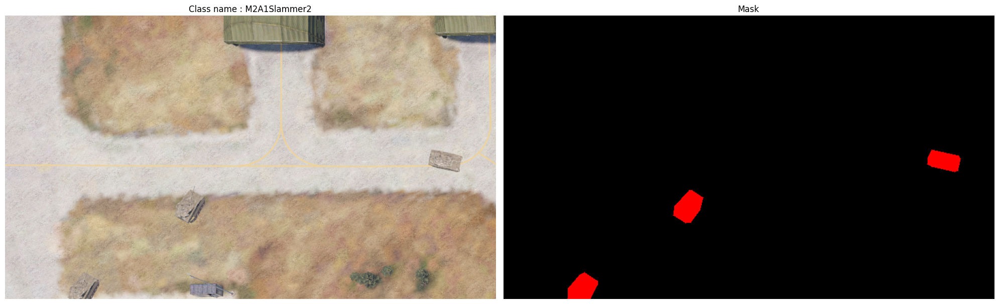

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_11.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_11.png


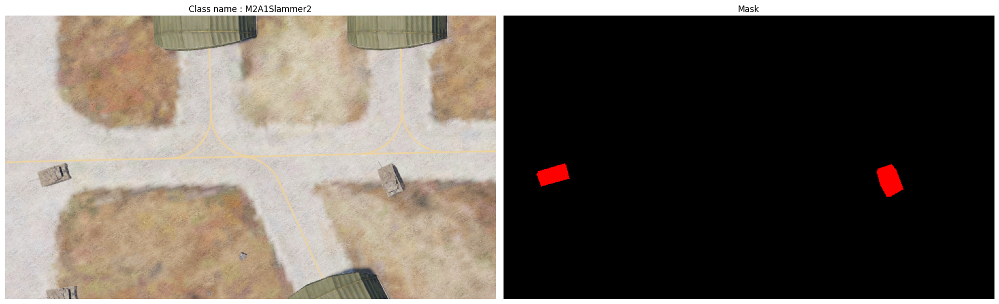

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_12.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_12.png


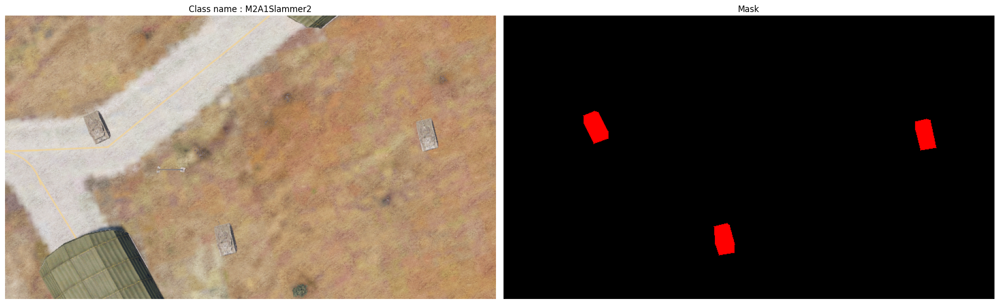

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_14.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_14.png


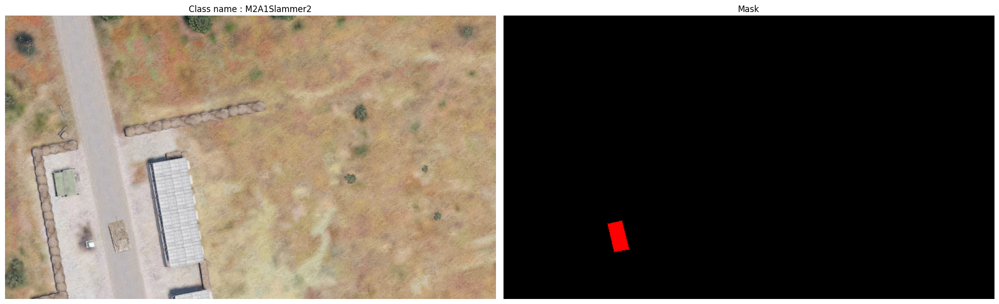

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_15.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_15.png


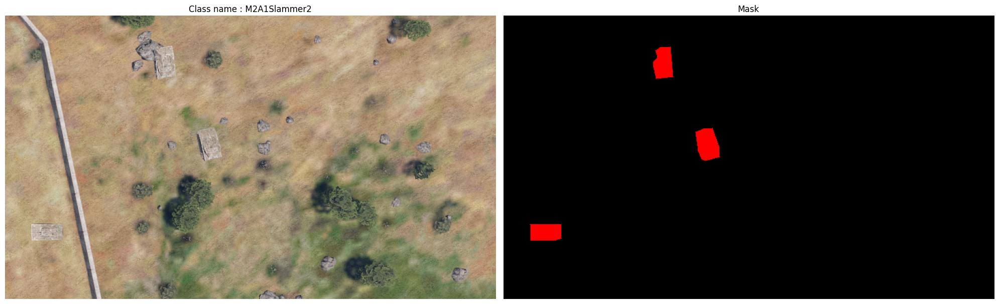

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_17.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_17.png


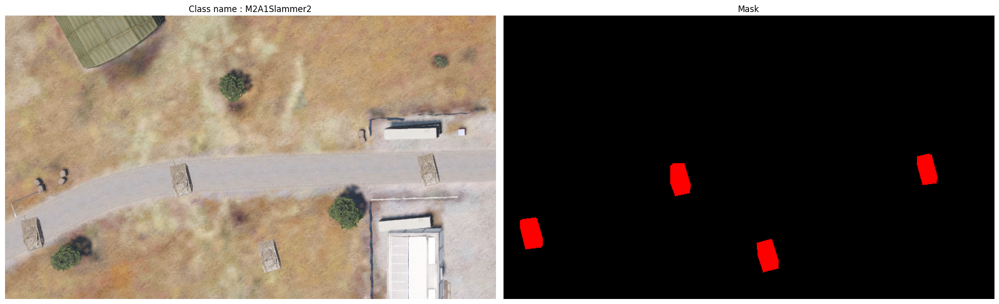

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_19.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_19.png


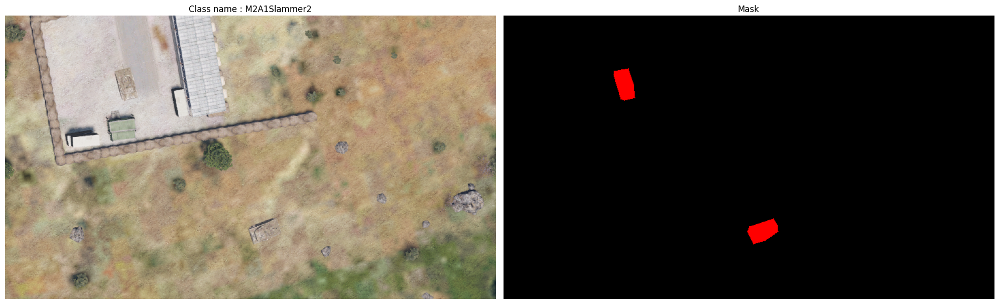

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_2.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_2.png


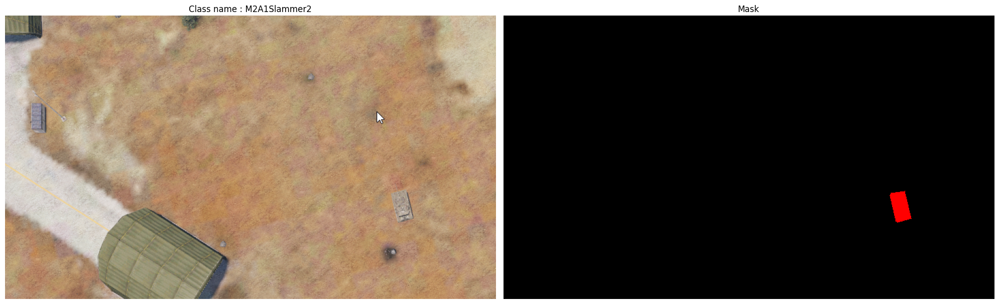

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_21.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_21.png


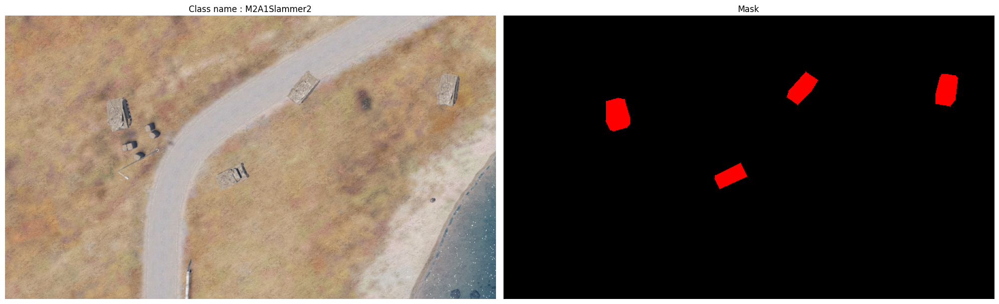

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_23.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_23.png


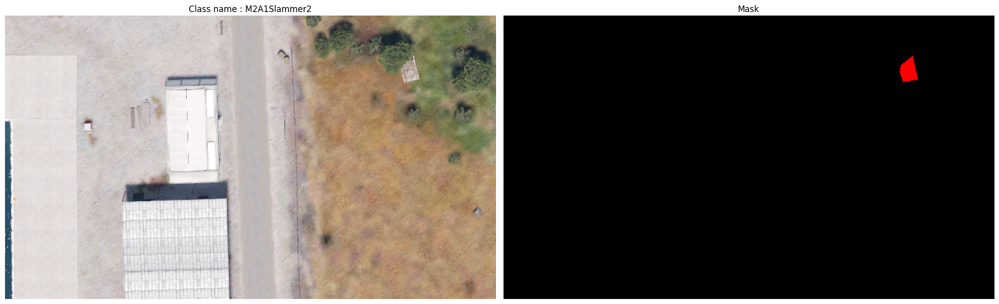

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_24.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_24.png


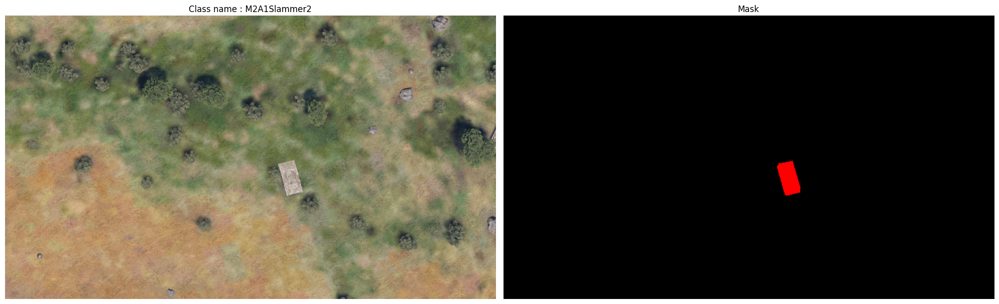

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_25.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_25.png


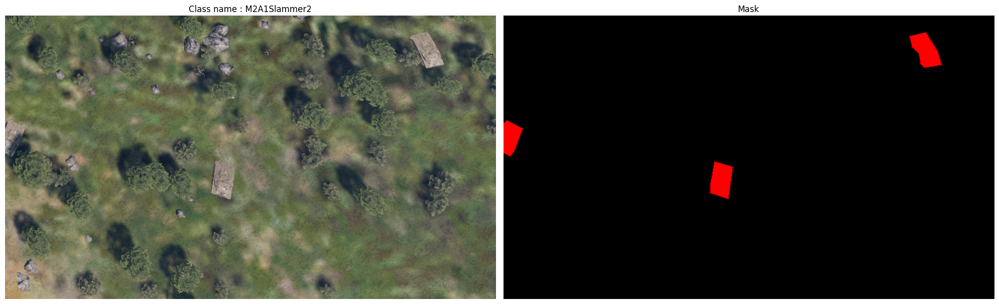

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_3.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_3.png


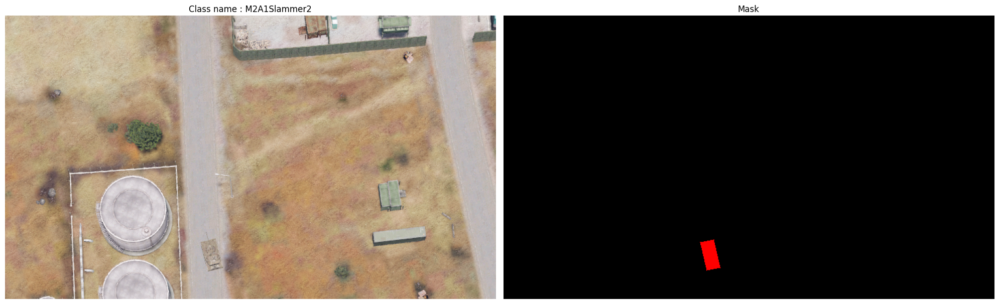

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_4.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_4.png


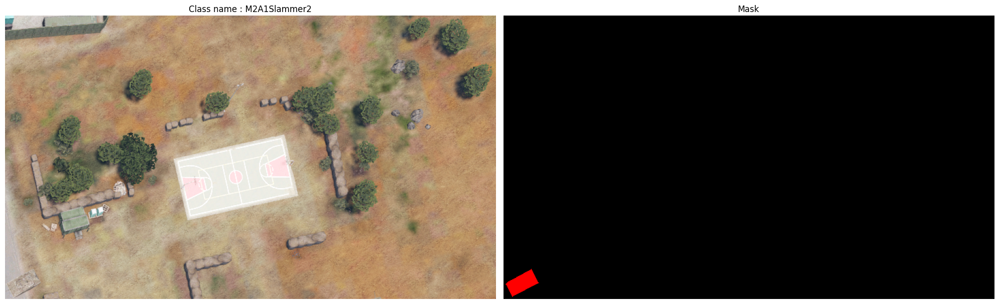

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_5.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_5.png


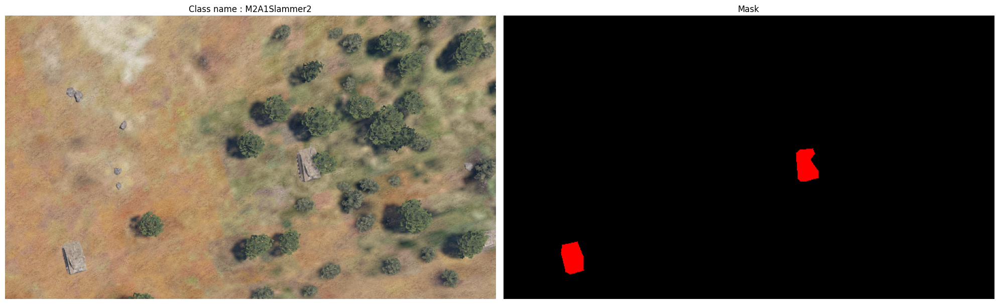

class_ :  M2A1Slammer2
M2A1Slammer2
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/train/images/M2A1Slammer2__part_9.png
filename /disk3/eric/dataset/Weapon_System/segmentation_pipes/maskimgs/M2A1Slammer2__part_9.png


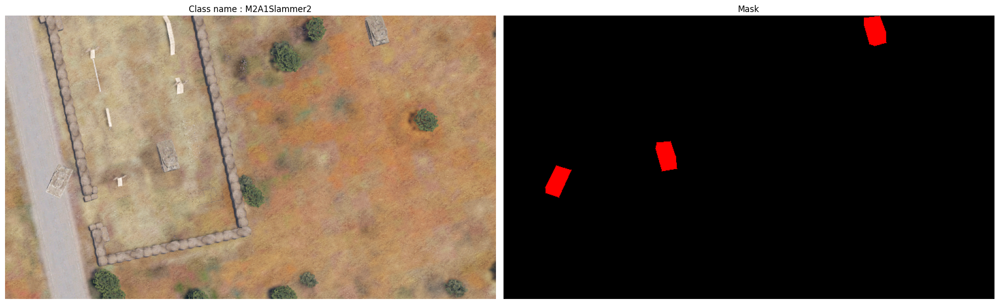

class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  M5Sandstorm
M5Sandstorm
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :  T140Angara
T140Angara
class_ :

In [82]:
import matplotlib.pyplot as plt


target_name = "M2A1Slammer2"
# Assuming train_imgs and train_mask are lists or arrays of images and masks
cnt = 0 
for img_, mask_ in zip(train_imgs, train_mask):
    class_ = img_.split("/")[-1].split("__")[0]
    print("class_ : ", class_)
    print(class_.split(".")[0].split("_")[0])
    if (class_ == target_name) or (class_.split(".")[0].split("_")[0] == target_name ):
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))  # Create a 1x2 grid for side-by-side display
        img = Image.open(img_)
        mask = Image.open(mask_)

        # Display the input image
        ax[0].imshow(img)  # Adjust cmap if the images are RGB
        ax[0].set_title(f"Class name : {class_}")
        ax[0].axis("off")  # Turn off axis ticks
        
        # Display the corresponding mask
        ax[1].imshow(mask)  # Adjust cmap if the masks are RGB or binary
        ax[1].set_title("Mask")
        ax[1].axis("off")  # Turn off axis ticks
        
        plt.tight_layout()
        plt.show()  # Show each pair side-by-side
        cnt +=1
        
        if cnt == 25:
            break
